# Predicting the breed of a dog based on an image using Graphlab's neural network to extract deep features and Sci-Kit learn's ensemble and linear models to make predictions. 

## A Brief Look Back at the State-of-the-art in Machine Vision in 2014:

<center>Flickr's Park or Bird Website - Released on 10/20/2014!</center>

<center><img src="http://imgs.xkcd.com/comics/tasks.png"></center>

- Press Release: http://code.flickr.net/2014/10/20/introducing-flickr-park-or-bird/  
- Site: http://parkorbird.flickr.com/

## Executive Summary

For my capstone project, I built a supervised learning algorithm to predict a dog's breed out of 120 breeds, based on an image. The train and test images were sourced from Stanford's dog dataset (http://vision.stanford.edu/aditya86/ImageNetDogs/). The dataset consisted of 20,580 labeled images of dogs, each belonging to one of 120 dog breeds. From this dataset I selected a random, equally balanced subset of 12,000 images, 80 training images, 20 test images per class.

I used GraphLab's off-the-shelf artificial neural network to pull the deep features from the images. I tested a number of scikit-learn's machine learning classifiers to predict the breed, ultimately settling upon their support vector machine classifier for it's superior performance (best accuracy score) on this classification task. 

## Problem Statement

The goal of this project was three-fold:

**1)** To build a working supervised machine learning model that could predict the breed of a dog with an accuracy score of at least 50%.

**2)** To build an interface in Jupyter Notebook that allows the user to test the model on an image of her choice in a way that's pleasurable and reinforces an understanding of the steps required, mainly: image acquisition, image processing (deep feature extraction), conversion of deep feature arrays to individual columns (one feature per column) for modeling, model training and model prediction. 

**3)** To report metrics back to the user on other, highly scored predicted breeds from the model in instances where the model does not predict the breed accurately. 

## The Data

The dataset consisted of 20,580 labeled images of dogs, each belonging to one of 120 dog breeds. The data was clean and the distribution of images per class was fairly balanced and can be seen in the histogram and barchart below: 

In [1]:
from PIL import Image
from IPython.display import display
import matplotlib.pyplot as plt
%matplotlib inline

def show_sample_image(fp):
    sample_image = Image.open(fp)
    display(sample_image)

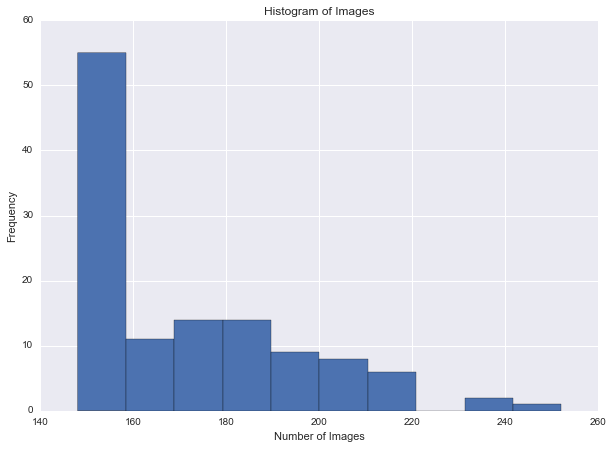

In [2]:
#Histogram showing distribution of images:
show_sample_image('assets/Histogram1.png')

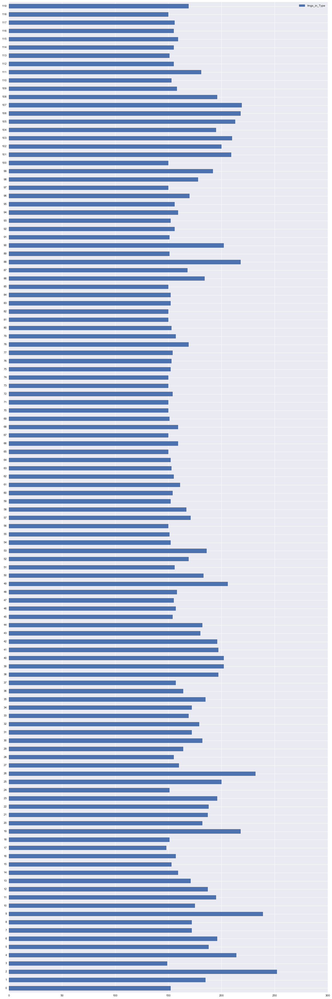

In [3]:
#Horizontal Barchart of the number of images per breed
show_sample_image('assets/Barchart1.png')

## The Images

The data consisted of images like the ones below:

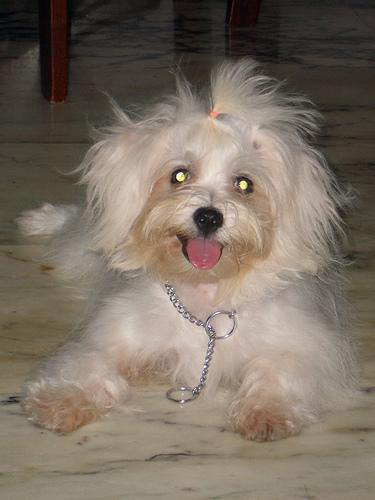

In [4]:
# Maltese
show_sample_image('assets/Maltese.png')

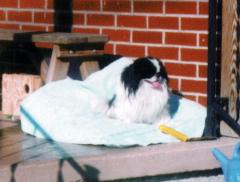

In [5]:
# Japanese Spaniel
show_sample_image('assets/Dog2.png')

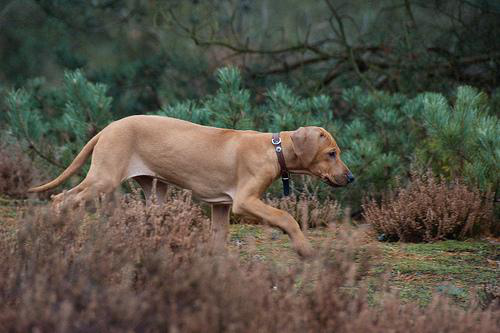

In [6]:
# Rhodesian Ridgeback
show_sample_image('assets/Dog3.png')

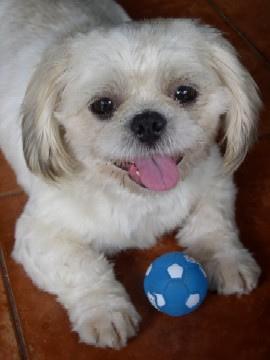

In [7]:
# Shih Tzu
show_sample_image('assets/Dog4.png')

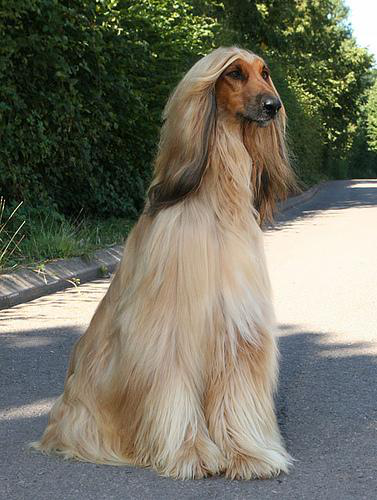

In [8]:
# Afghan Hound
show_sample_image('assets/Dog5.png')

## Approach

I used vanilla Python and pandas for all data manipulation and dataframe creation. I used Graphlab for deep feature extraction and scikit-learn classifiers to model (explained in further detail below).  

At a high level, this problem was a multi-class classification problem that I solved using a supervised learning algorithm (SLA). To solve this problem, I needed to train an SLA on some well balanced subset of images and then test its performance on an equally well balanced subset of test images that it had never "seen" before. 

Diving a little deeper, there were three core steps required to spin up this vision project end to end. I was delighted to learn that these three core steps were not radically dissimilar from the steps a data scientist would carry out on other, non-vision related problems. These three steps are:

1) **Data Collection.** All Images were sourced from Stanford's dog dataset. Thankfully, the Stanford dog dataset was a relatively humane, clean and well-balanced set of images.

2) **Feature Extraction/Engineering.** From these images, we needed to extract the features held within the images. In image processing and machine vision, every pixel is a feature of that image. However, before a pixel can be used as a feature in a model, we must perform a linear transformation on the pixel's RGB value. Once we retrieve this linearly transformed value, we can then use this value as a feature in our model. I used Graphlab's off-the-shelf neural network, specifically their DeepFeatureExtractor, in order to extract the linearly transformed values of my images' pixels for use in modeling.

3) **Modeling.** Once the features were extracted, I split the data into an 80%/20% train, test split. I then fit a number of models to my training data using Scikit-learn's linear and ensemble classification models to see which returned the highest accuracy score. Specifically, I used: Ada Boost (on a decision tree), Gradient Boost, Random Forest, Extra Trees, XG Boost, Logistic Regression and a Support Vector Machine. I ultimately ended up sticking with their support vector machine classifier for it's superior accuracy score performance on this classification task, 65.5%.

After I fit the model I built a function that would allow a user to interact with the model from Jupyter notebook. The function allows the user to use any downloaded image as a test image for model prediction. This function also returns a dataframe with the 5 highest breeds predicted by the model. 

## Analysis

After fitting a series of models on the data and looking to optimize the accuracy scores, I found that scikit-learn's support vector machine classifier achieved the highest accuracy on this classification task at 65.5%.

The accuracy score is defined as:

(True Positives + True Negatives)/(True Positives + True Negatives + False Positives + False Negatives)

I also explored each model's F1 score, another measure of the model's accuracy and these painted a very similar picture to the accuracy scores.

A complete list of the model's accuracy scores can be seen below:

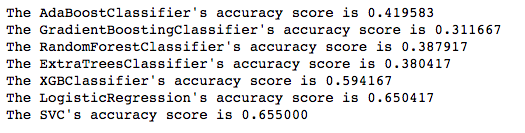

In [9]:
show_sample_image('assets/Accuracy_Scores.png')

The model claassified certain breeds more accurately than others in the test set. Below we can see how accurately the model performed on the test set, broken down by breed:

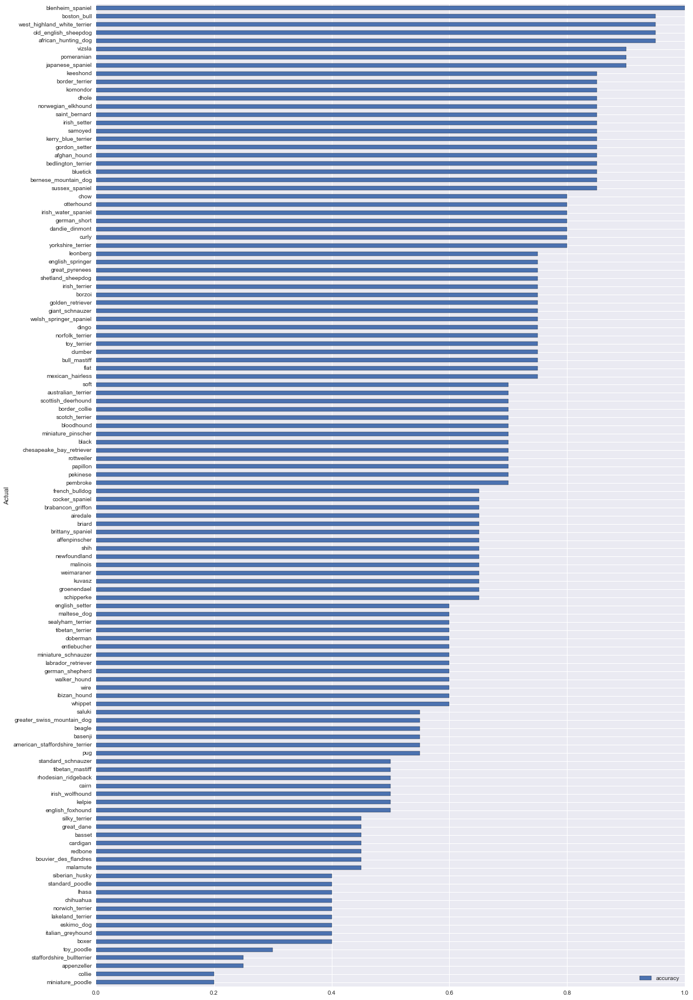

In [10]:
show_sample_image('assets/ModelPerformancebyBreed.png')

## Conclusion

To conclude, I was able to build a model using Graphlab and scikit-learn that was 65.5% accurate at this classification task. Additionally, I built two functions that allow the user to experiment with the model and get feedback on what the model's top predictions are for a given image. These functions, predictedProbabilitiesofBreedRandom and predictedProbabilitiesDownload, are in the Source Code section below.  

## Discussion

I've been an avid spectator of developments in the machine vision space since 2013, and it was a lot of fun (and really rewarding) to complete this first machine vision project end-to-end from a technical perspective. As illustrated in the Brief Look Back snippet above, it seems that there has been immense technological progress in this space, even since October 2014, that has enabled newcomers with a passion in the subject to carry out their own experiments with relatively little overhead.

I learned a lot by doing this project and wanted to highlight a few of the more technical lessons learned while doing this project. 

- Be mindful of the data types you're using and don't deviate into new data-types willy-nilly. This will have unintended consequences. Any choice to change from a familiar, stable data-type should be deliberate and well thought out. 
    - I learned this lesson when experimenting with Graphlab's version of a DataFrame, the Sframe. Converting to this data-type had many unintended consequences. Importantly, I couldn't use scikit-learn's algorithms on an Sframe.

- Don't fall in love with the first code you write that works.
    - I might have saved myself several days time if I had scrapped my decision to use an SFrame early on for a short-term gain (mainly the DeepFeatureExtractor and unpack methods worked well on Sframes). I should have been more considerate to my future self.  

- Image processing takes a long time, so build that into your planning.
    - My expectations of the speed at which I would be able to process images (extract their deep features) was completely out of sync with reality. I used Graphlab for all deep feature extraction and it took roughly 23 hours to extract the features from 12,000 images, which I was not expecting. This time consideration is the reason why I ultimately decided to model on 12,000 images as opposed to 20,580. I now understand that 23 hours is not that long to wait but it was still an eye opener for me. 

- Test on small bits of code
    - Building a bit on the last bullet point, the amount of time I lost unpacking features was compounded by the fact that I kept trying to unpack the images all at once. At times, the unpacking failed and this meant I had to start from the beginning. 

- Your model's score is telling you something important and will reflect any methodical errors you may have made. Take note.
    - I initially had a 50%/50% train test split, which was yielding me accuracy scores in the low 60's%. I decided to increase the train split to 80% to improve the accuracy score, however, I improperly balanced the classes in the dataframe. After I ran the model again on this improperly balanced train split (i.e. certain dog breeds were very over-represented) my model score decreased. I didn't know why this could be but after speaking to Alex, he suggested I take a look at the balance of my data, which turned out to be the cause of the decreased model performance.

## Next Steps

There are several next steps I would take to improve upon this model to get an improved accuracy score. First, I would try extracting the features from all 20,580 images included in the Stanford image dataset. With this larger set of images I would run an 80%, 20% train-test split and see if the model's performance increased just because it was trained on more data.

Next, I would try scaling the images to a higher resolution to see if this provides any improvement in model accuracy. For this project, I used 440X380 pixels, which was governed by the pixel width and height of the lowest resolution image in the dataset. This image was not a statistical outlier in terms of resolution so I kept it in the data but on a second iteration of this project I would explore the tradeoff between removing lower resolution images while still maintaining a large volume of images to train the model. 

My final "next step" is not quite as low-hanging as the first two, and it would be to experiment with alternative deep feature extractors. Graphlab was a good choice for this project because it was free to me as a General Assembly student and was easy to use. However, there are many other players in the market, both proprietary (like SIFT) and open-source, like TensorFlow. I am confident that with some time I might be able to build an ANN that performs better on this task.

## Source Code

In [11]:
import pandas as pd
from random import randint
import numpy as np
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier, RandomForestClassifier, ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn import svm
from sklearn.tree import DecisionTreeClassifier
import xgboost
from IPython.display import display
import matplotlib.pyplot as plt
from PIL import Image

def show_sample_image(fp):
    sample_image = Image.open(fp)
    display(sample_image)

//anaconda/envs/py27/lib/python2.7/site-packages/sklearn/cross_validation.py:44: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


In [18]:
# Load pickled dataframe containing labels and deep features extracted from a subset of 12k images.
# Features extracted using Graphlab's DeepFeatureExtractor, which will use again shortly. 
finalDF = pd.read_pickle('assets/finalDF')

In [13]:
# Preview of the Dataframe:
finalDF.head(10)

,dog_type,0,1,2,3,4,5,6,7,8,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,chihuahua,0.000000,0.000000,0.000000,0.0,0.000000,0.00000,0.000000,0.000000,0.0,...,0.000000,0.0,0.0,0.000000,1.003293,0.0,0.000000,0.0,0.000000,0.00000
1,chihuahua,0.000000,0.000000,0.000000,0.0,0.000000,0.00000,0.136024,0.000000,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.179927,0.0,0.000000,0.00000
2,chihuahua,1.075629,0.000000,0.000000,0.0,0.000000,0.00000,0.000000,1.258296,0.0,...,0.000000,0.0,0.0,0.000000,0.902666,0.0,1.078462,0.0,0.000000,0.00000
3,chihuahua,2.233127,0.288371,0.000000,0.0,0.000000,0.00000,0.000000,0.000000,0.0,...,0.000000,0.0,0.0,0.947621,1.126941,0.0,0.369847,0.0,0.000000,0.24312
4,chihuahua,1.091078,0.000000,1.651373,0.0,0.000000,0.00000,0.000000,0.000000,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.00000
5,chihuahua,0.000000,0.000000,2.611599,0.0,0.000000,0.00000,0.000000,0.000000,0.0,...,2.323014,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.008274,0.00000
6,chihuahua,3.496384,1.014011,0.000000,0.0,3.690080,0.00000,0.000000,0.000000,0.0,...,0.000000,0.0,0.0,2.695065,1.226368,0.0,3.581688,0.0,0.000000,0.00000
7,chihuahua,1.648270,0.000000,0.000000,0.0,0.000000,0.97872,0.000000,0.000000,0.0,...,0.000000,0.0,0.0,0.000000,0.184890,0.0,2.080956,0.0,0.718470,0.00000
8,chihuahua,2.036031,0.000000,3.322879,0.0,0.129573,0.00000,1.147767,0.000000,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.00000
9,chihuahua,0.840349,0.000000,0.000000,0.0,0.000000,0.00000,0.000000,0.000000,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.00000


In [14]:
# Train/Test split of our dataframe. We grab 80 train images per class and test on 20 test images per class.
Xtrain, Xtest, ytrain, ytest = finalDF.groupby('dog_type').head(80), finalDF.groupby('dog_type').tail(20), finalDF.groupby('dog_type').head(80), finalDF.groupby('dog_type').tail(20)

In [15]:
# Dropping labels from our df so that we keep just features
Xtrain.drop("dog_type", axis=1, inplace=True)
Xtest.drop("dog_type", axis=1, inplace=True)

/anaconda/envs/py27/lib/python2.7/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app
/anaconda/envs/py27/lib/python2.7/site-packages/ipykernel/__main__.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()


In [16]:
# Droping features from df so that we keep just labels
ytrain = ytrain['dog_type']
ytest = ytest['dog_type']

In [17]:
# Check the shape of our df's:
print(Xtrain.shape, ytrain.shape, Xtest.shape, ytest.shape)

((9600, 4096), (9600,), (2400, 4096), (2400,))


## Models

In [18]:
# Defining all the classification algorithms we'll be using and putting them into a list
ad = AdaBoostClassifier(DecisionTreeClassifier())
gb = GradientBoostingClassifier()
rf = RandomForestClassifier()
xt = ExtraTreesClassifier()
xg = xgboost.XGBClassifier()
lr = LogisticRegression()
svmclf = svm.SVC(decision_function_shape='ovo', probability=True)
#modelList = [ad,gb,rf,xt,xg,lr,svmclf]
modelList = [svmclf]

In [19]:
# creating a function that allows us to fit every model in our list and return model scores. 
def testModels(modelsList, Xtrain, Xtest, ytrain, ytest):
    for model in modelsList:
        model.fit(Xtrain, ytrain);
        score = model.score(Xtest, ytest)
        modelName = str(model).rsplit('(')[0]
        print("The %s's accuracy score is %f" % (modelName, score))

In [20]:
# Fitting our models, returning accuracy scores. 
testModels(modelList, Xtrain, Xtest, ytrain, ytest)

The SVC's accuracy score is 0.655000


#### Predict a random dog's breed based on an image!

In [20]:
import graphlab
from graphlab import SFrame
graphlab.canvas.set_target('ipynb')

# Here we write a function that scales an image to a standard size, 440x380, and calls Graphlab's DeepFeatureExtractor to extract the linearly transformed features from the image. These are the features we will use to classify the image into a dog's breed. 
def deepFeatureExtraction(fp):
    img = graphlab.Image(fp)
    ppsf = graphlab.SArray([img])
    ppsf = graphlab.image_analysis.resize(ppsf, 440,380) 
    ppsf = graphlab.SFrame(ppsf).rename({'X1': 'image'})
    extractor = graphlab.feature_engineering.DeepFeatureExtractor(features='image', model='auto')
    extractor = extractor.fit(ppsf)
    return extractor.transform(ppsf)['deep_features.image']

In [21]:
# Picks a random dog from test set and makes a prediction. If it gets it wrong, shows the predicted probabilities:
def predictedProbabilitiesofBreedRandom():
    root = '/Users/mikeroman/Sites/General_Assembly/GA-DSI/projects/projects-capstone/part-01/'
    imagefpDF = pd.read_pickle('/Users/mikeroman/Dropbox/Education/General Assembly/Data Science Immersive - Q4 2016/GA-DSI-Saves/December/2016-12-12 CAPSTONE/projects-capstone/part-05/Pickled_DFs/image_filepaths')
    trainlabels = pd.read_pickle('/Users/mikeroman/Dropbox/Education/General Assembly/Data Science Immersive - Q4 2016/GA-DSI-Saves/December/2016-12-12 CAPSTONE/projects-capstone/part-05/Pickled_DFs/trainDF')
    testlabels = pd.read_pickle('/Users/mikeroman/Dropbox/Education/General Assembly/Data Science Immersive - Q4 2016/GA-DSI-Saves/December/2016-12-12 CAPSTONE/projects-capstone/part-05/Pickled_DFs/testDF')
    x = randint(1,2400)
    y = [x-1][0]
    a = randint(1,140)
    b = [a-1][0]
    predictedBreed = pd.DataFrame(zip(svmclf.classes_, svmclf.predict_proba(Xtest.iloc[y:x,:])[0]), columns=["Dog_Breed", "Predicted_Probability"]).sort(columns="Predicted_Probability", ascending=False).head(1).iloc[0][0]
    actualBreed = ytest[Xtest.iloc[y:x,:].index.values[0]]
    fpActualBreed = root+imagefpDF[imagefpDF["dog_type"]==actualBreed].iloc[b:a,:].iloc[0][0]
    fpPredictedBreed = root+imagefpDF[imagefpDF["dog_type"]==predictedBreed].iloc[b:a,:].iloc[0][0]
    print("Here's a picture of the lovely %s you've selected at random:" % actualBreed)
    show_sample_image(fpActualBreed)
    print("Time for us to venture a prediction as to the breed...")
    if predictedBreed == actualBreed:
        print("Looks like we nailed it. Your image was a %s and that's what we predicted." % actualBreed)
    else:
        print("Dang, looks like we didn't get this one. We thought it was a picture of a %s but it was actually a %s." % (predictedBreed, actualBreed))
        show_sample_image(fpPredictedBreed)
        print("Here's a look at our top 5 predicted breeds for this image:")
        return display(pd.DataFrame(zip(svmclf.classes_, svmclf.predict_proba(Xtest.iloc[y:x,:])[0]), columns=["Dog_Breed", "Predicted_Probability"]).sort(columns="Predicted_Probability", ascending=False).head())

In [ ]:
predictedProbabilitiesofBreedRandom()

In [ ]:
# This function predicts the breed of a dog by returning the dog breed with the highest predict_proba from the already fit SVM model. It also returns a dataframe showing the top 5 predicted probability dog breeds and their relative probabalities. 
def predictedProbabilitiesDownload():
    predictedBreed = pd.DataFrame(zip(svmclf.classes_, svmclf.predict_proba(userDownloadedImagesdf.iloc[:1,:])[0]), columns=["Dog_Breed", "Predicted_Probability"]).sort(columns="Predicted_Probability", ascending=False).head(1).iloc[0][0]
    print("Here's a picture of the lovely dog you've downloaded from the internet:")
    show_sample_image(dlimgFP)
    print("Time for us to venture a prediction as to the breed...")
    print("Our crystal ball tells us this is a %s. Did we get it right?" % predictedBreed)
    print("If not, these would have been our next guesses:")
    return display(pd.DataFrame(zip(svmclf.classes_, svmclf.predict_proba(userDownloadedImagesdf.iloc[0:1,:])[0]), columns=["Dog_Breed", "Predicted_Probability"]).sort(columns="Predicted_Probability", ascending=False).head())

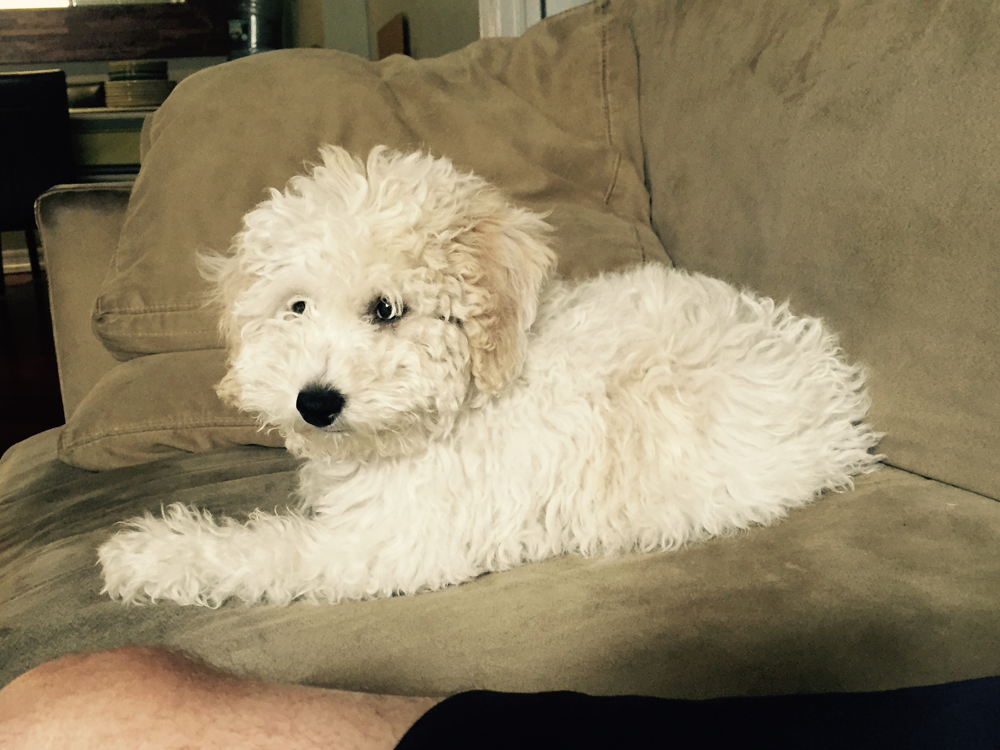

In [25]:
#Set dlimgFP equal to the filepath of the dog image you would like a prediction of.
dlimgFP = '/Users/mikeroman/Downloads/fullsizeoutput_63.jpeg'
show_sample_image(dlimgFP)

In [26]:
# Creates a df, userDownloadedImagesdf and extracts Graphlab deep features into this df. 
userDownloadedImagesdf = pd.DataFrame()
userDownloadedImagesdf["deep_features"] = deepFeatureExtraction(dlimgFP)

#Clean df of unneeded indexes and unpack the deep features so that there's one feature per column:
for x in range(0, len(userDownloadedImagesdf['deep_features'])):
    userDownloadedImagesdf = userDownloadedImagesdf.append([userDownloadedImagesdf['deep_features'][x]])
userDownloadedImagesdf.drop("deep_features", axis=1, inplace=True)
userDownloadedImagesdf.reset_index(inplace=True)
userDownloadedImagesdf = userDownloadedImagesdf.drop(0)
userDownloadedImagesdf = userDownloadedImagesdf.drop("index", axis=1)

This non-commercial license of GraphLab Create for academic use is assigned to mroman09@gmail.com and will expire on November 15, 2017.


[INFO] graphlab.cython.cy_server: GraphLab Create v2.1 started. Logging: /tmp/graphlab_server_1491928594.log


Downloading https://static.turi.com/products/graphlab-create/resources/models/python2.7/imagenet_model_iter45/dir_archive.ini to /var/tmp/graphlab-mikeroman/41646/bb4a3efe-e3b4-4f40-a2c4-2b4ad59bfb8a.ini

Downloading https://static.turi.com/products/graphlab-create/resources/models/python2.7/imagenet_model_iter45/objects.bin to /var/tmp/graphlab-mikeroman/41646/fbe539b4-5466-49af-a625-26180c251192.bin

Images being resized.

In [27]:
userDownloadedImagesdf

,0,1,2,3,4,5,6,7,8,9,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
1,0.0,0.0,5.063805,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.491741,2.841117,0.0,0.865974,0.0,0.0,0.0,0.0,0.0,0.0


/anaconda/envs/py27/lib/python2.7/site-packages/ipykernel/__main__.py:3: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  app.launch_new_instance()


Here's a picture of the lovely dog you've downloaded from the internet:


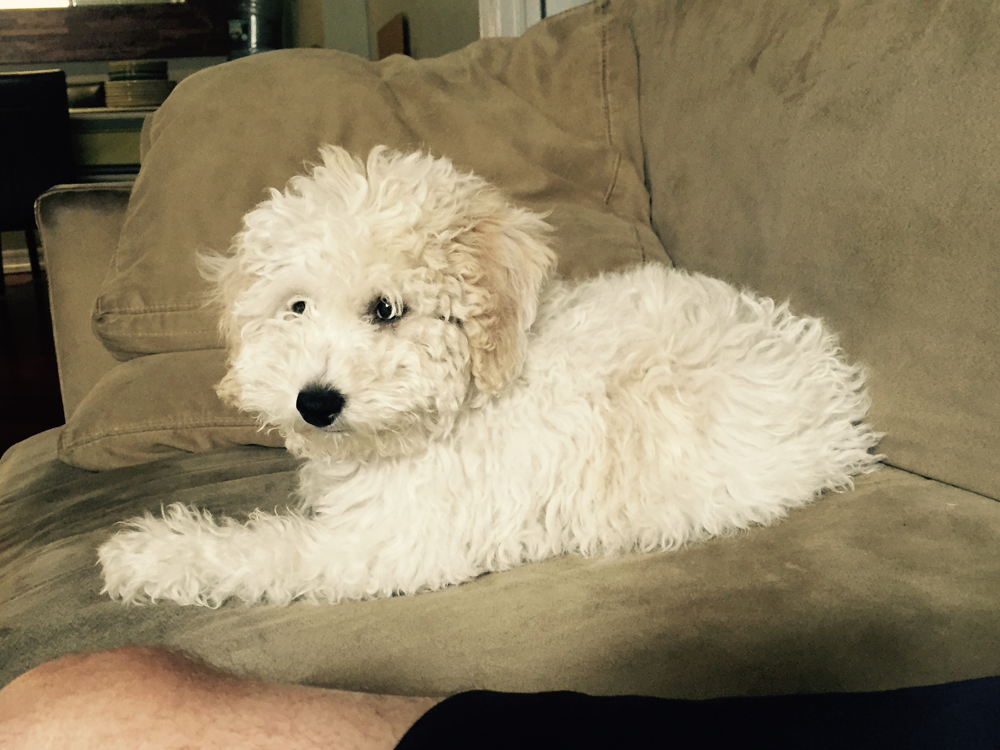

Time for us to venture a prediction as to the breed...
Our crystal ball tells us this is a kuvasz. Did we get it right?
If not, these would have been our next guesses:


/anaconda/envs/py27/lib/python2.7/site-packages/ipykernel/__main__.py:9: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)


,Dog_Breed,Predicted_Probability
66,kuvasz,0.182888
110,toy_poodle,0.178585
76,miniature_poodle,0.103890
94,samoyed,0.071860
30,chow,0.060441


In [53]:
# Execute this line of code to run your image through the model and get its prediction of the dog breed.
predictedProbabilitiesDownload()